In [1]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

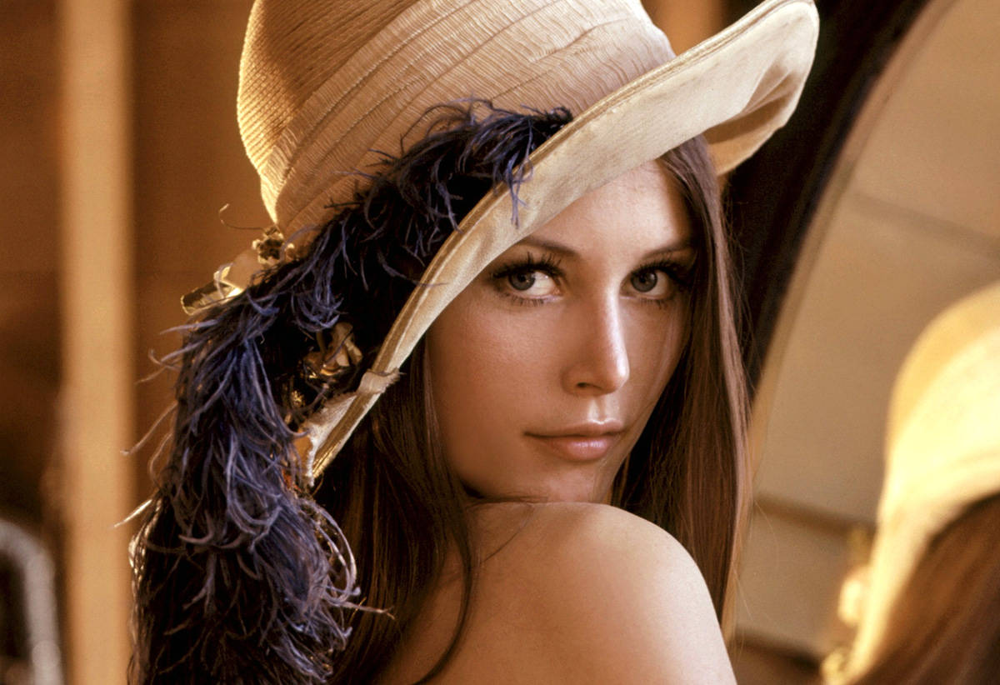

In [2]:
img1=Image.open("./img2.jpeg")
img1

In [4]:
img1.info.get('dpi')

(72, 72)

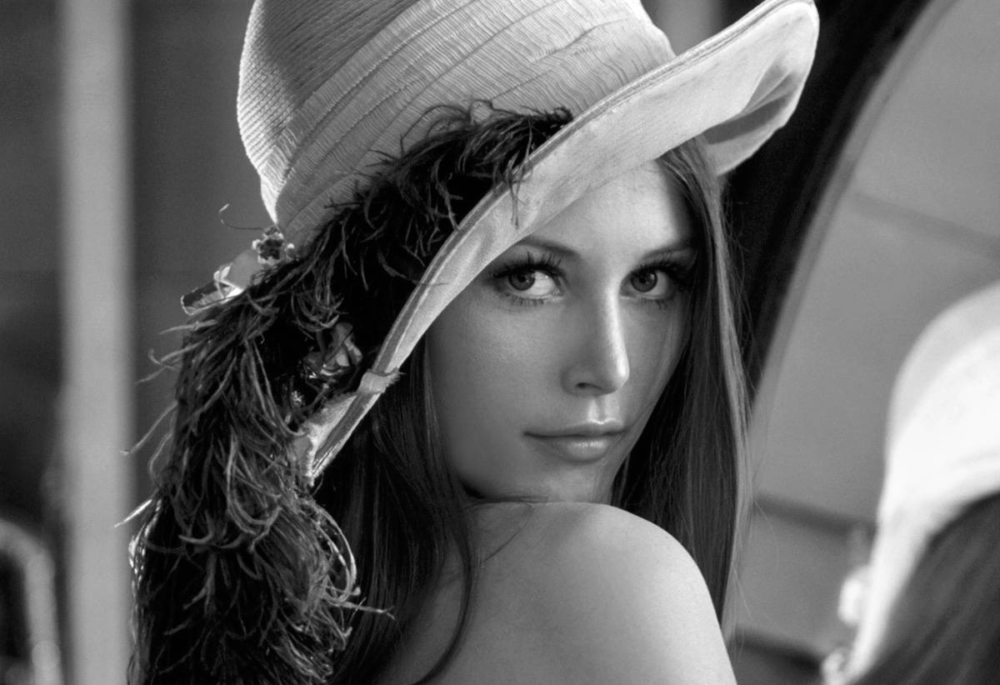

In [5]:
img_gray=img1.convert("L")
img_gray

In [7]:
img_gray.save('./gray.jpg',dpi=(400,400))

In [11]:
img2=Image.open('./gray.jpg')

In [12]:
img2.info.get('dpi')

(400, 400)

In [13]:
img2.mode

'L'

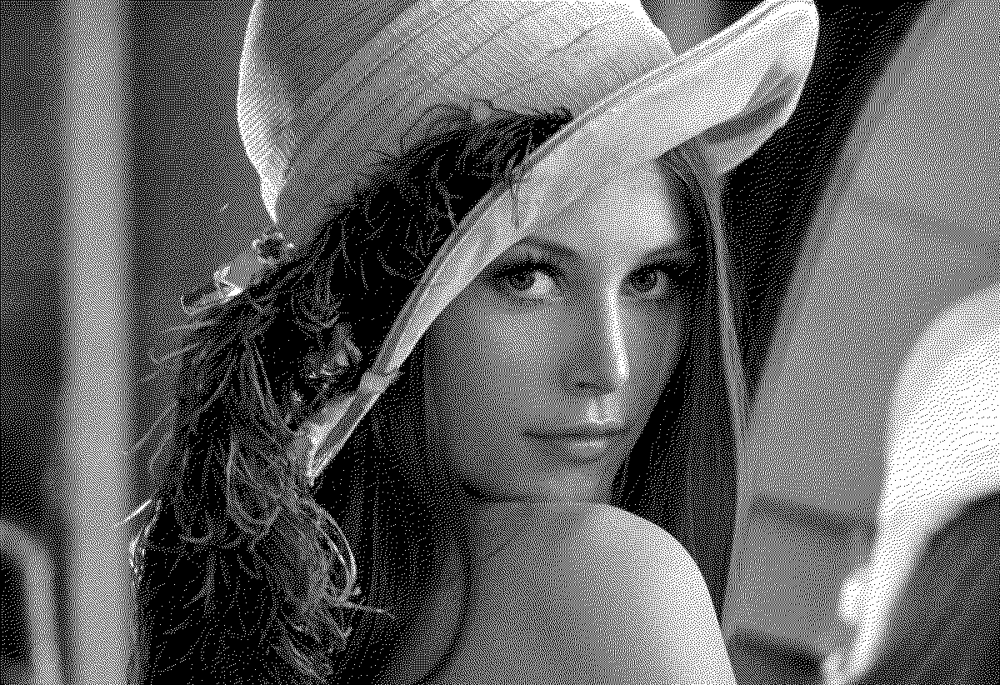

In [14]:
binary_img=img1.convert('1')
binary_img

In [15]:
binary_img.mode

'1'

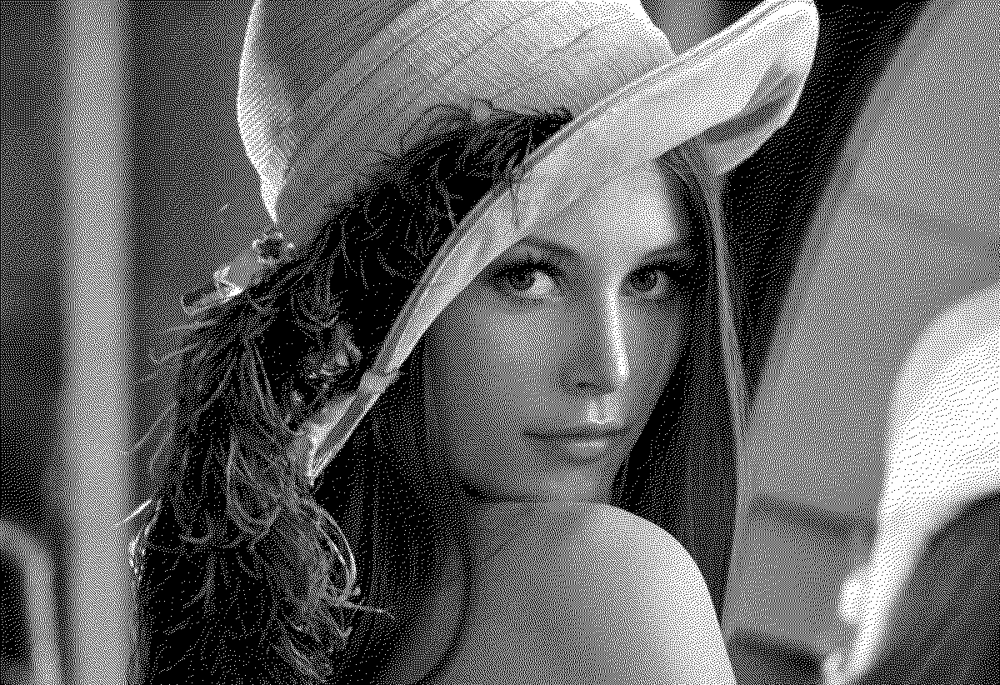

In [16]:
binary_gray=img2.convert("1")
binary_gray

In [17]:
plt.figure(figsize=(100,200))

<Figure size 10000x20000 with 0 Axes>

<Figure size 10000x20000 with 0 Axes>

Text(0.5, 1.0, 'Binary Image')

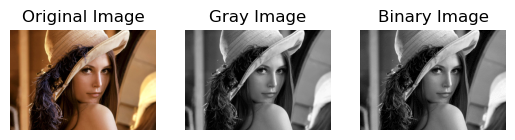

In [20]:
plt.subplot(1,3,1)
plt.imshow(img1)
plt.axis("off")
plt.title('Original Image')

plt.subplot(1,3,2)
plt.imshow(img_gray,cmap="gray")
plt.axis("off")
plt.title('Gray Image')

plt.subplot(1,3,3)
plt.imshow(binary_img,cmap="gray",vmax=255,vmin=0)
plt.axis("off")
plt.title('Binary Image')

In [22]:
gray_arr=np.array(img_gray)
gray_arr

array([[ 53,  52,  52, ..., 144, 144, 144],
       [ 56,  54,  53, ..., 144, 144, 144],
       [ 58,  56,  54, ..., 144, 144, 144],
       ...,
       [ 41,  39,  37, ...,  31,  32,  32],
       [ 36,  35,  33, ...,  31,  31,  31],
       [ 33,  31,  29, ...,  31,  30,  30]], dtype=uint8)

In [23]:
binary_arr=np.array(binary_img)
binary_arr

array([[False, False, False, ...,  True, False,  True],
       [False,  True, False, ...,  True, False,  True],
       [False, False, False, ...,  True, False,  True],
       ...,
       [False, False,  True, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [24]:
unique_binary_values=np.unique(binary_arr)
unique_binary_values

array([False,  True])

In [25]:
rgb_arr=np.array(img1)
rgb_arr

array([[[ 84,  45,  14],
        [ 83,  44,  13],
        [ 84,  43,  13],
        ...,
        [185, 134,  89],
        [185, 134,  89],
        [185, 134,  89]],

       [[ 87,  48,  17],
        [ 85,  46,  15],
        [ 85,  44,  14],
        ...,
        [185, 134,  89],
        [185, 134,  89],
        [185, 134,  89]],

       [[ 89,  50,  19],
        [ 87,  48,  17],
        [ 86,  45,  15],
        ...,
        [185, 134,  89],
        [185, 134,  89],
        [185, 134,  89]],

       ...,

       [[ 54,  38,  23],
        [ 53,  35,  21],
        [ 52,  33,  18],
        ...,
        [ 49,  26,  10],
        [ 50,  27,  11],
        [ 50,  27,  11]],

       [[ 47,  33,  20],
        [ 48,  32,  19],
        [ 47,  29,  15],
        ...,
        [ 49,  26,  10],
        [ 49,  26,  10],
        [ 49,  26,  10]],

       [[ 44,  31,  15],
        [ 42,  29,  13],
        [ 42,  26,  10],
        ...,
        [ 49,  26,  10],
        [ 48,  25,   9],
        [ 48,  25,   9]]

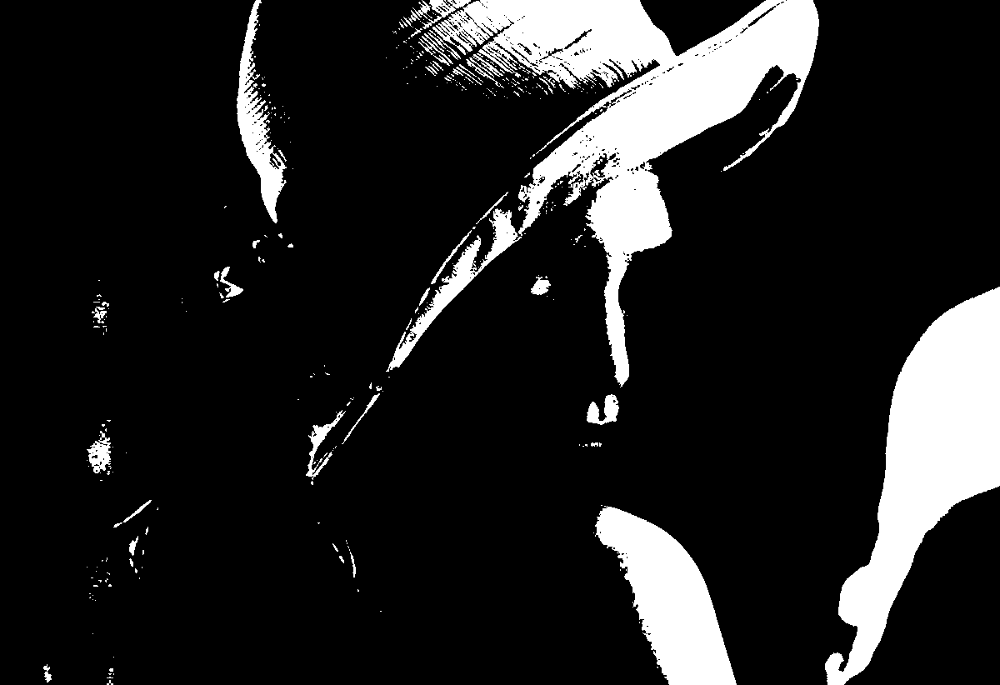

In [26]:
threshold=170
threshold_gray_image=img_gray.point(lambda x:255 if x>threshold else 0)
threshold_gray_image

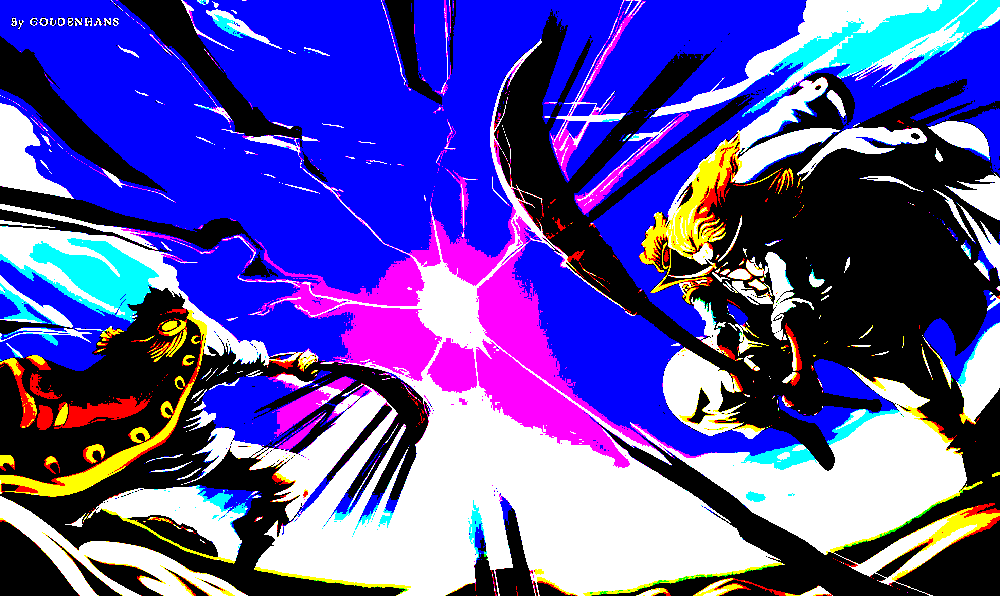

In [30]:
one_piece_img=Image.open("./img1.jpg")
one_piece_threshold=one_piece_img.point(lambda x:255 if x>threshold else 0)
one_piece_threshold

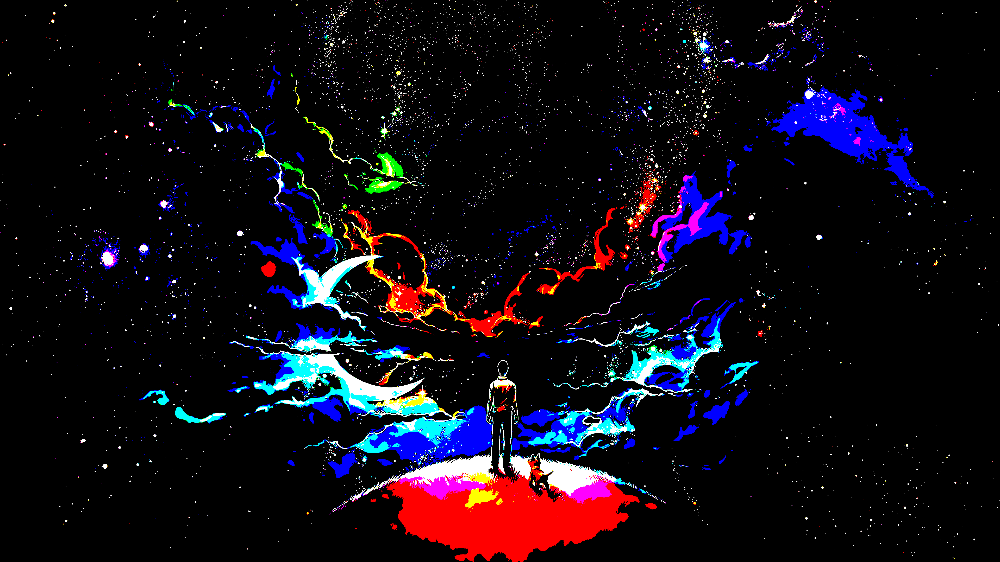

In [34]:
img3=Image.open("./img6.jpg")
img3_threshold=img3.point(lambda x:255 if x>128 else 0)
img3_threshold

In [35]:
r,g,b=img3.split()
r_arr=np.array(r)
g_arr=np.array(g)
b_arr=np.array(b)

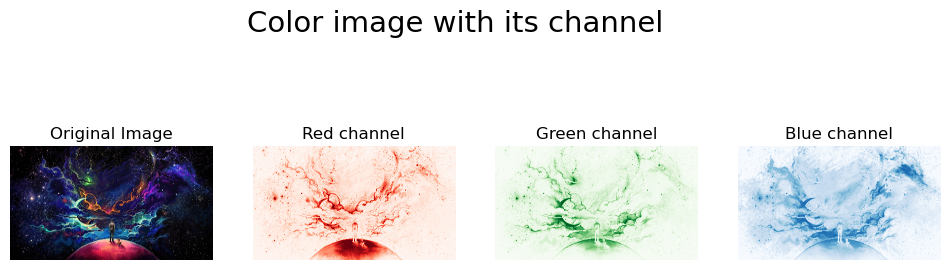

In [39]:
fig,axs=plt.subplots(1,4,figsize=(12,4))

axs[0].imshow(img3)
axs[0].set_title("Original Image")
axs[0].axis("off")

axs[1].imshow(r_arr,cmap="Reds")
axs[1].set_title("Red channel")
axs[1].axis("off")

axs[2].imshow(g_arr,cmap="Greens")
axs[2].set_title("Green channel")
axs[2].axis("off")

axs[3].imshow(b_arr,cmap="Blues")
axs[3].set_title("Blue channel")
axs[3].axis("off")

fig.suptitle("Color image with its channel ",fontsize=21)

plt.show()

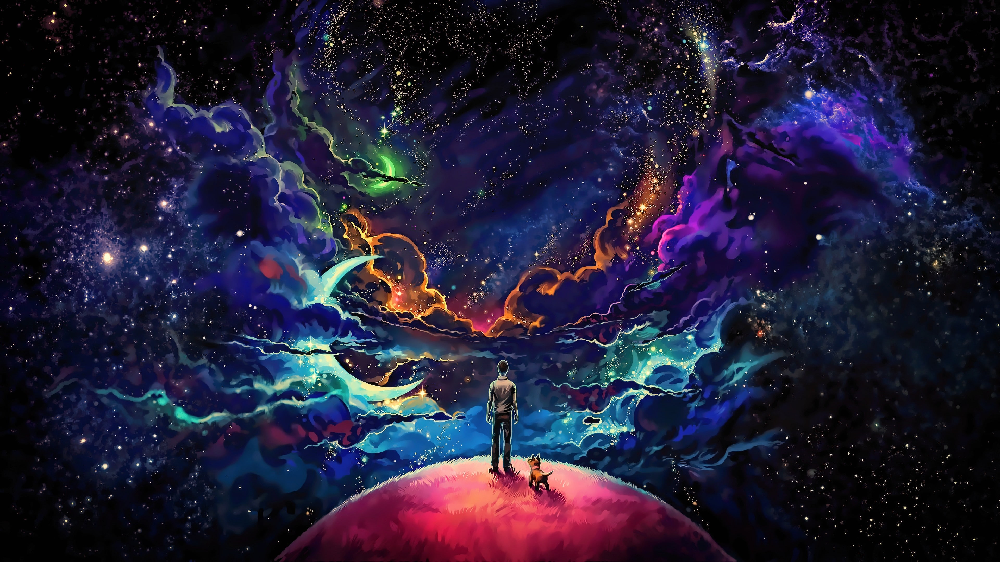

In [42]:
merge_img=Image.merge("RGB",(r,g,b))
merge_img

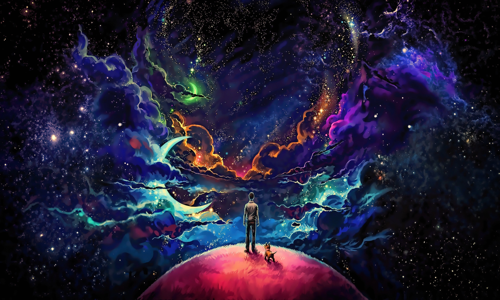

In [44]:
resized_image=img3.resize((500,300))
resized_image

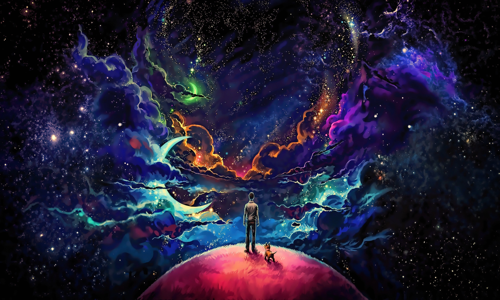

In [45]:
resized_image2=img3.resize((500,300),Image.BICUBIC)
resized_image2

[[89 50 19]
 [86 45 15]
 [89 44 15]
 [89 44 11]
 [89 44 11]]


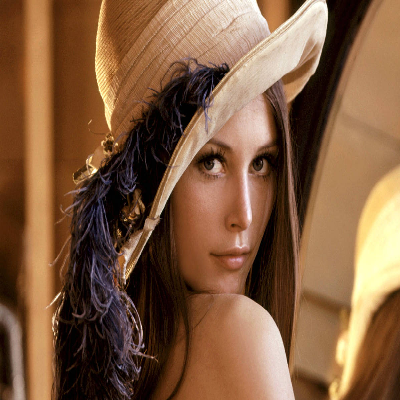

In [40]:
def custom_resize(img,size):
    img_size = img.size 
    original_arr = np.array(img)
    
    row = img_size[1] / size[0]
    col = img_size[0] / size[1]
    resized_shape = (size[0], size[1], original_arr.shape[2]) if len(original_arr.shape) == 3 else (size[0], size[1])
    imgNp = np.zeros(resized_shape, dtype=np.uint8)
    for i in range(size[0]):
        for j in range(size[1]):
            imgNp[i][j]=original_arr[int(i*row)][int(j*col)]
    a=Image.fromarray(imgNp)
    print(imgNp[1][:5])
    return a
custom_resize(img1,(400,400))
    
    


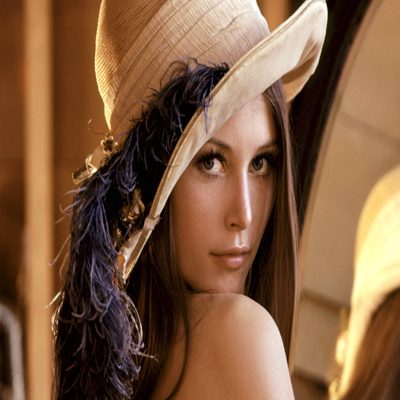

In [76]:
img1.resize((400,400))

In [44]:
b=np.array([
            [[1,2,4],[3,5,5]],
            [[2,4,6],[6,5,6]],
            [[1,2,4],[3,5,5]],
            [[2,4,6],[6,5,6]]
            ]
            )
a=imgNp = np.zeros((2,2,3), dtype=np.uint8)
b[0][0]

for i in range(2):
    for j in range(2):
        a[i][j]=b[i][j]

b.shape

(4, 2, 3)